# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on the Celeb A dataset which is a large set of celebrity face images.

In [1]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
from gan.utils import show_images, sample_noise
#torch.backends.cudnn.deterministic=True
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [2]:
from gan.train import train

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076). 

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [4]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [5]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). 

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [6]:
from gan.models import Discriminator, Generator

# Data loading: Celeb A Dataset

The CelebA images we provide have been filtered to obtain only images with clear faces and have been cropped and downsampled to 128x128 resolution.

In [7]:
batch_size = 64
scale_size = 128  # We resize the images to 64x64 for training

celeba_root = '/media/sigai/88e954d1-83a2-4df0-90c6-1e296ca4bdc0/celeba_data'

In [8]:
celeba_train = ImageFolder(root=celeba_root, transform=transforms.Compose([
  transforms.Resize(scale_size),
  transforms.ToTensor(),
]))

celeba_loader_train = DataLoader(celeba_train, batch_size=batch_size, drop_last=True)
print(len(celeba_loader_train))

1972


### Visualize dataset

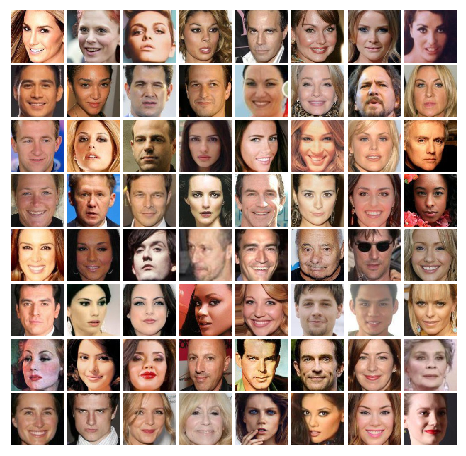

In [9]:
imgs = celeba_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [10]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.0002
continue_train = False


### Train GAN

In [11]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

if continue_train:
    G.load_state_dict(torch.load("mygenerator.pt"))
    D.load_state_dict(torch.load("mydiscriminator.pt"))

In [12]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1


/usr/local/lib/python3.5/dist-packages/torch/nn/functional.py:995: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


Iter: 0, D: 1.501, G:2.98


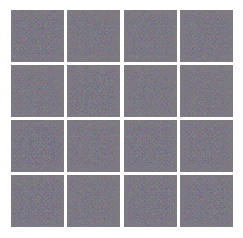


Iter: 250, D: 1.064, G:2.339


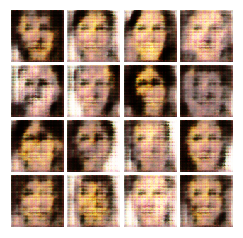


Iter: 500, D: 1.019, G:2.359


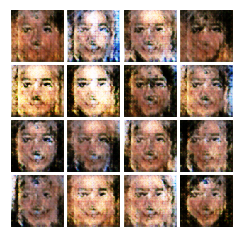


Iter: 750, D: 1.05, G:1.99


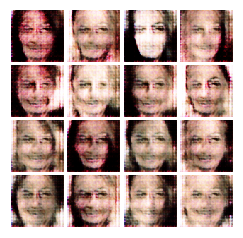


Iter: 1000, D: 0.9576, G:2.804


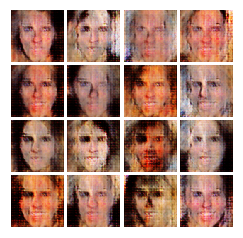


Iter: 1250, D: 1.194, G:1.319


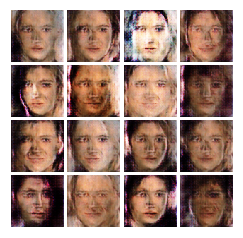


Iter: 1500, D: 0.81, G:2.691


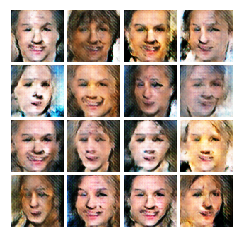


Iter: 1750, D: 1.18, G:2.418


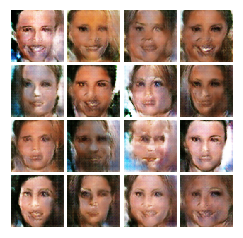


EPOCH:  2
Iter: 2000, D: 1.148, G:2.054


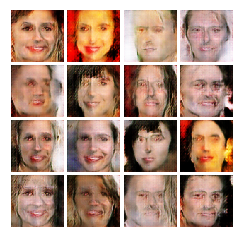


Iter: 2250, D: 1.559, G:1.386


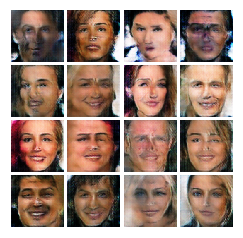


Iter: 2500, D: 0.9762, G:1.703


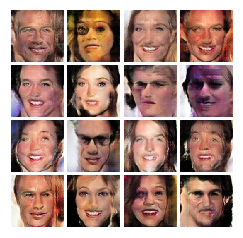


Iter: 2750, D: 1.396, G:0.9405


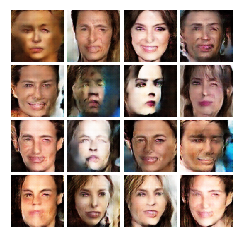


Iter: 3000, D: 1.247, G:1.233


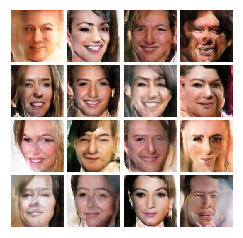


Iter: 3250, D: 1.08, G:1.344


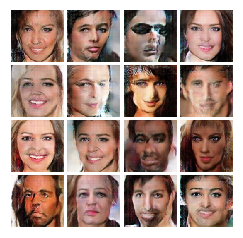


Iter: 3500, D: 1.218, G:1.059


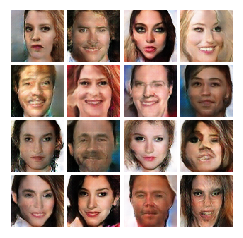


Iter: 3750, D: 1.165, G:1.309


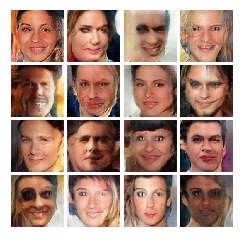


EPOCH:  3
Iter: 4000, D: 1.312, G:2.51


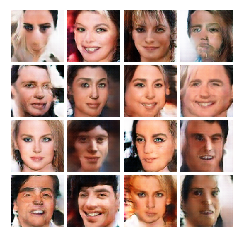


Iter: 4250, D: 1.044, G:1.598


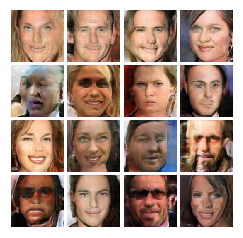


Iter: 4500, D: 1.18, G:1.915


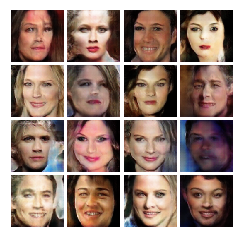


Iter: 4750, D: 1.106, G:1.594


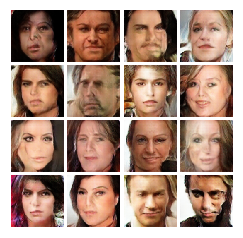


Iter: 5000, D: 1.219, G:1.298


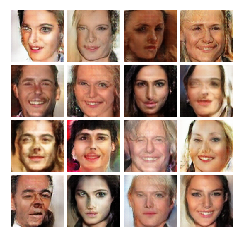


Iter: 5250, D: 1.342, G:1.063


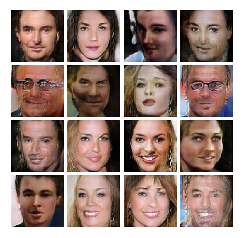


Iter: 5500, D: 1.139, G:1.067


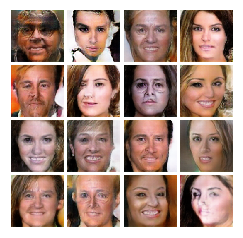


Iter: 5750, D: 1.088, G:0.8316


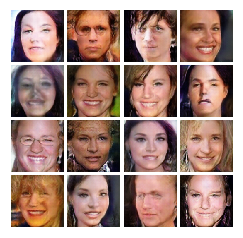


EPOCH:  4
Iter: 6000, D: 1.145, G:1.948


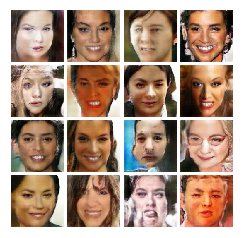


Iter: 6250, D: 1.142, G:0.8797


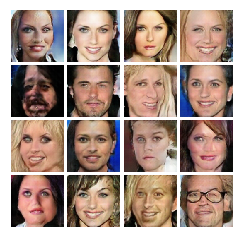


Iter: 6500, D: 0.9611, G:2.115


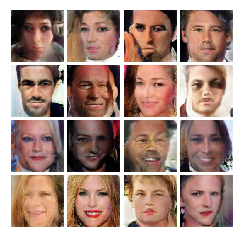


Iter: 6750, D: 0.8257, G:1.664


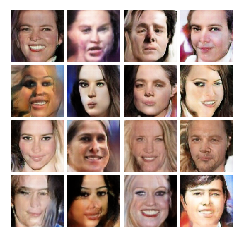


Iter: 7000, D: 0.9245, G:1.457


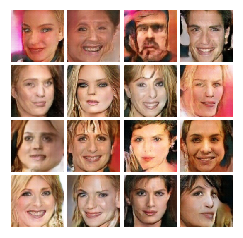


Iter: 7250, D: 1.082, G:1.978


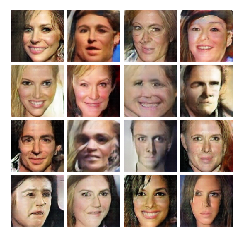


Iter: 7500, D: 1.083, G:0.975


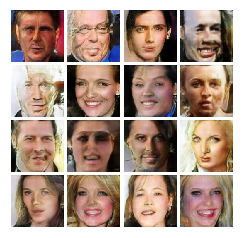


Iter: 7750, D: 0.9977, G:1.684


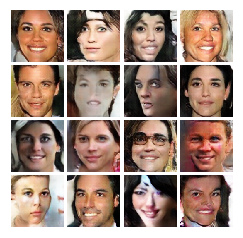


EPOCH:  5
Iter: 8000, D: 0.7888, G:2.127


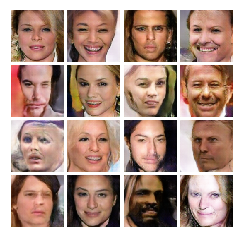


Iter: 8250, D: 0.8578, G:1.556


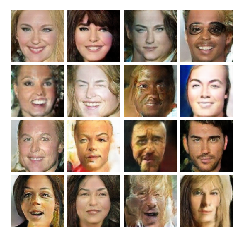


Iter: 8500, D: 0.8394, G:1.836


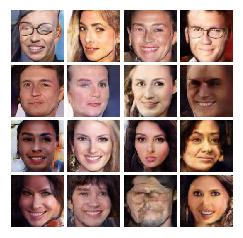


Iter: 8750, D: 0.9385, G:1.746


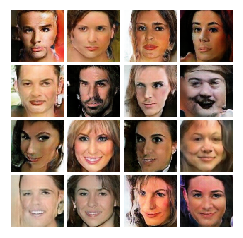


Iter: 9000, D: 0.9622, G:2.405


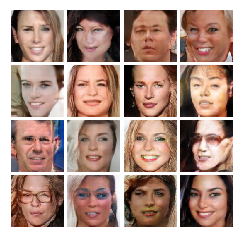


Iter: 9250, D: 0.6957, G:2.707


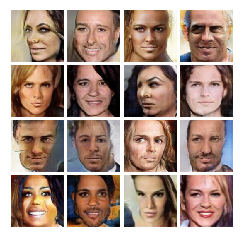


Iter: 9500, D: 0.733, G:1.947


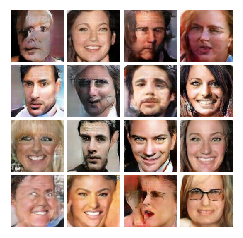


Iter: 9750, D: 0.797, G:1.57


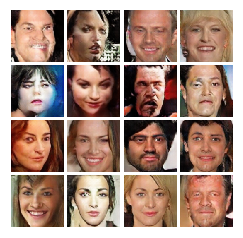


EPOCH:  6
Iter: 10000, D: 0.8852, G:2.447


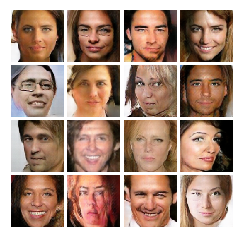


Iter: 10250, D: 1.031, G:1.972


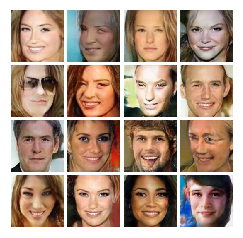


Iter: 10500, D: 0.4889, G:2.696


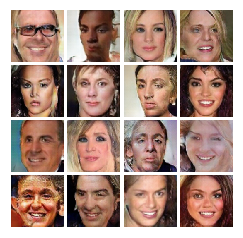


Iter: 10750, D: 0.8008, G:2.984


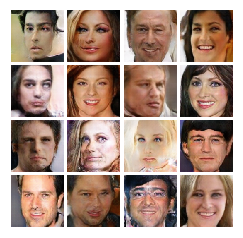


Iter: 11000, D: 1.13, G:1.184


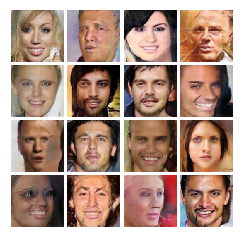


Iter: 11250, D: 0.7208, G:1.858


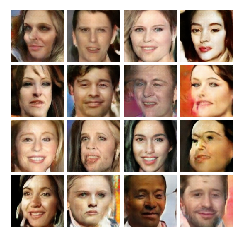


Iter: 11500, D: 0.8724, G:2.457


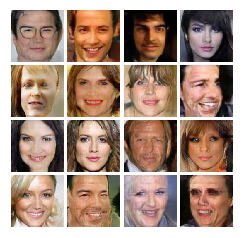


Iter: 11750, D: 0.7924, G:1.223


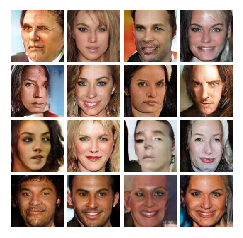


EPOCH:  7
Iter: 12000, D: 0.8078, G:1.405


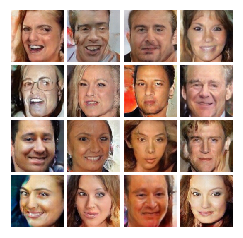


Iter: 12250, D: 0.5813, G:2.736


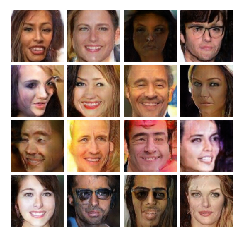


Iter: 12500, D: 0.9734, G:3.684


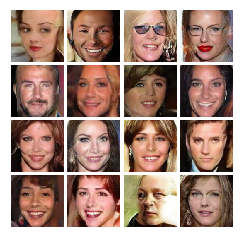

In [ ]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss,
          generator_loss,  batch_size=batch_size, num_epochs=NUM_EPOCHS, show_every=250,
          train_loader=celeba_loader_train, device=device)


In [ ]:
torch.save(D.state_dict(), "mydiscriminator.pt")
torch.save(G.state_dict(), "mygenerator.pt")

### Train LS-GAN

In [11]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [12]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1


/home/sigai/anaconda3/envs/py36/lib/python3.6/site-packages/torch/nn/functional.py:995: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")


Iter: 0, D: 0.533, G:0.6103


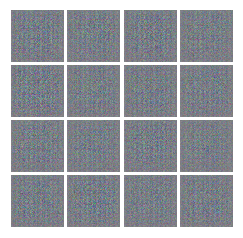


Iter: 200, D: 0.01367, G:0.5313


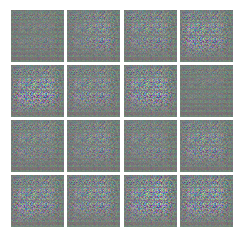


Iter: 400, D: 0.2297, G:0.1821


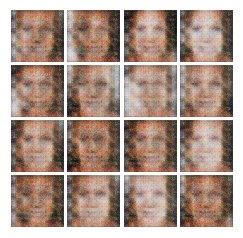


Iter: 600, D: 0.1779, G:0.6934


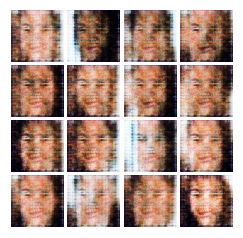


Iter: 800, D: 0.2832, G:0.5982


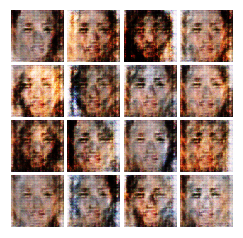


Iter: 1000, D: 0.1449, G:0.4523


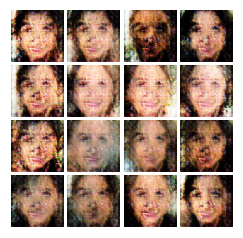


Iter: 1200, D: 0.3235, G:0.2373


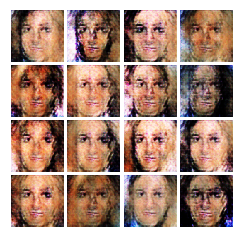


Iter: 1400, D: 0.4173, G:0.2281


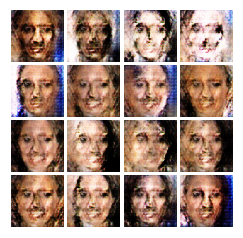


Iter: 1600, D: 0.1832, G:0.4982


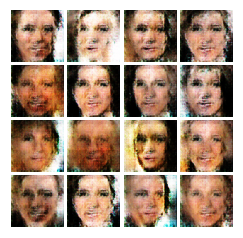


Iter: 1800, D: 0.1706, G:0.2696


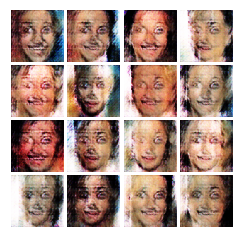


EPOCH:  2
Iter: 2000, D: 0.2546, G:0.3402


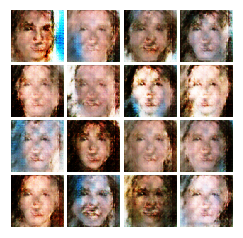


Iter: 2200, D: 0.1183, G:0.6399


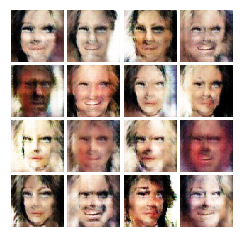


Iter: 2400, D: 0.08962, G:0.6953


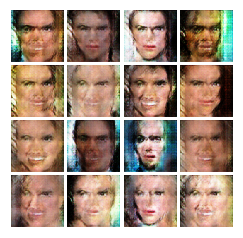


Iter: 2600, D: 0.178, G:0.5358


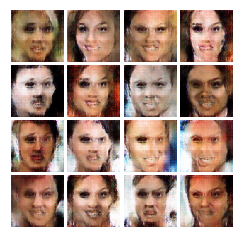


Iter: 2800, D: 0.1477, G:0.3326


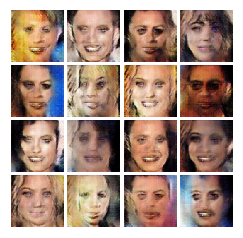


Iter: 3000, D: 0.234, G:0.2829


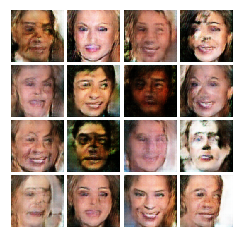


Iter: 3200, D: 0.1718, G:0.7037


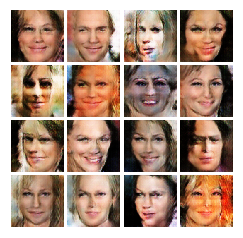


Iter: 3400, D: 0.2386, G:0.648


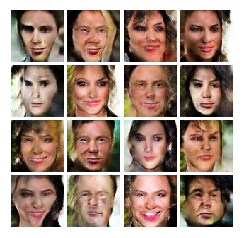


Iter: 3600, D: 0.1723, G:0.3719


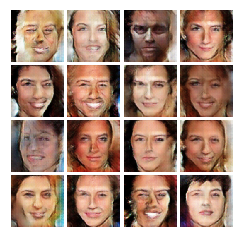


Iter: 3800, D: 0.2364, G:0.5116


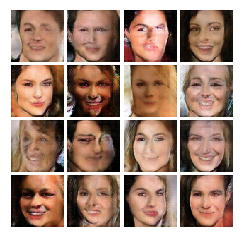


EPOCH:  3
Iter: 4000, D: 0.1668, G:0.3462


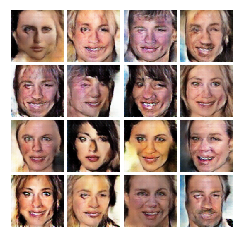


Iter: 4200, D: 0.2399, G:0.1569


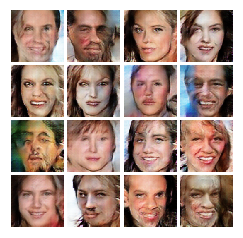


Iter: 4400, D: 0.1269, G:0.3591


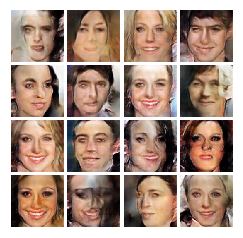


Iter: 4600, D: 0.1415, G:0.5272


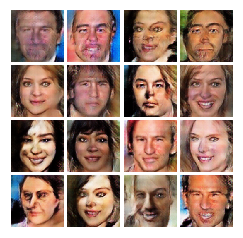


Iter: 4800, D: 0.2331, G:0.619


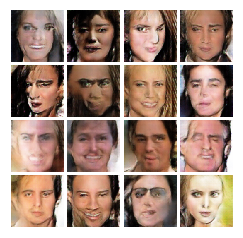


Iter: 5000, D: 0.407, G:0.131


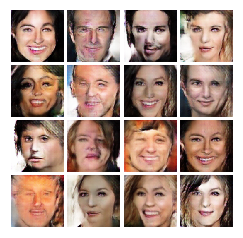


Iter: 5200, D: 0.1866, G:0.4178


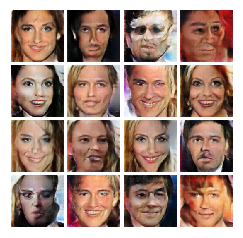


Iter: 5400, D: 0.1537, G:0.281


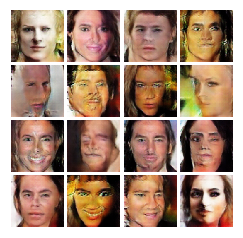


Iter: 5600, D: 0.1604, G:0.2914


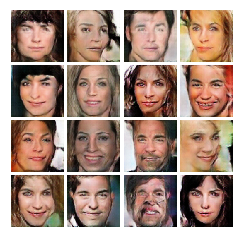


Iter: 5800, D: 0.1843, G:0.3167


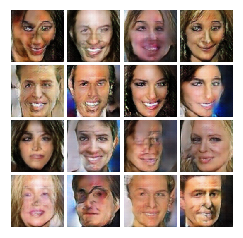


EPOCH:  4
Iter: 6000, D: 0.1657, G:0.293


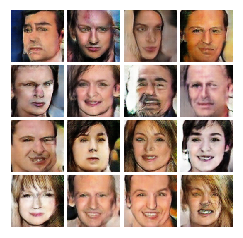

KeyboardInterrupt: 

In [13]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, batch_size=batch_size, show_every=200,
          train_loader=celeba_loader_train, device=device)

EPOCH:  1
Iter: 0, D: 0.136, G:0.4976


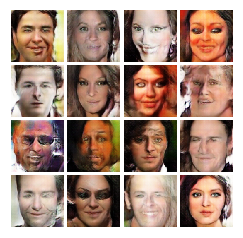


Iter: 200, D: 0.1542, G:0.2515


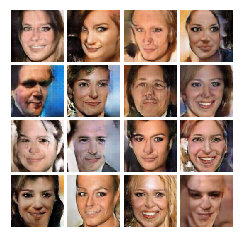


Iter: 400, D: 0.159, G:0.4485


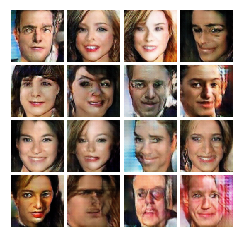


Iter: 600, D: 0.1378, G:0.4047


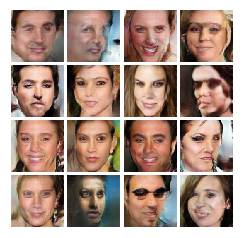


Iter: 800, D: 0.1451, G:0.1891


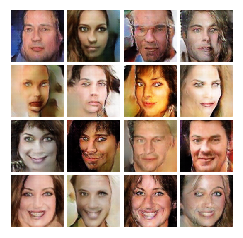


Iter: 1000, D: 0.1377, G:0.3795


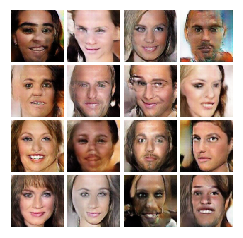


Iter: 1200, D: 0.1697, G:0.3418


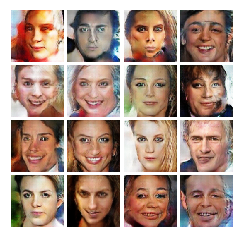


Iter: 1400, D: 0.1353, G:0.469


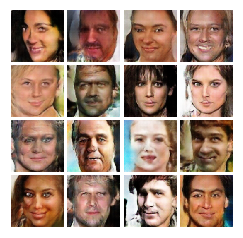


Iter: 1600, D: 0.2451, G:0.6139


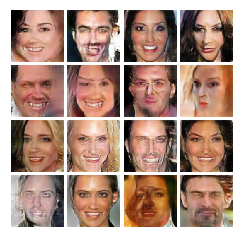


Iter: 1800, D: 0.1774, G:0.2124


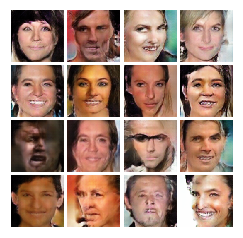


EPOCH:  2
Iter: 2000, D: 0.1093, G:0.4821


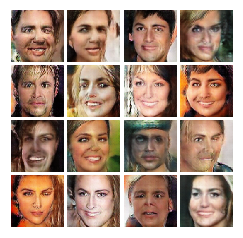


Iter: 2200, D: 0.136, G:0.3916


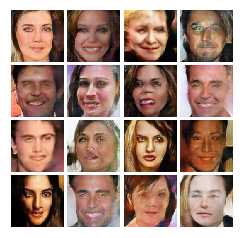


Iter: 2400, D: 0.1227, G:0.3023


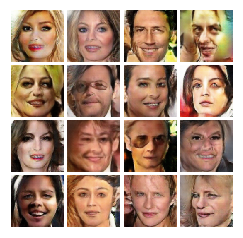


Iter: 2600, D: 0.2152, G:0.2669


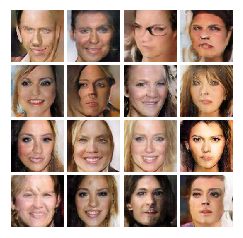


Iter: 2800, D: 0.1362, G:0.3653


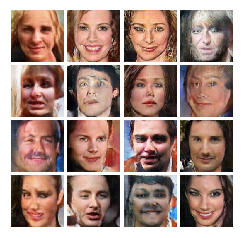


Iter: 3000, D: 0.1469, G:0.2829


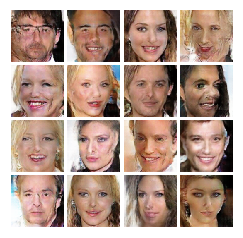


Iter: 3200, D: 0.098, G:0.212


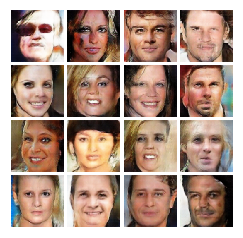


Iter: 3400, D: 0.2397, G:0.2604


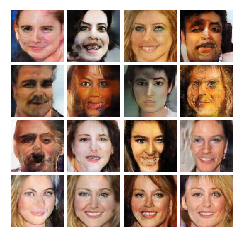


Iter: 3600, D: 0.1072, G:0.296


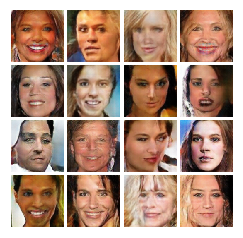


Iter: 3800, D: 0.08959, G:0.5196


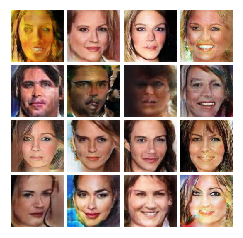


EPOCH:  3
Iter: 4000, D: 0.05397, G:0.3411


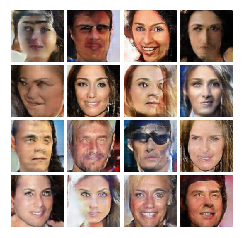


Iter: 4200, D: 0.1217, G:0.4146


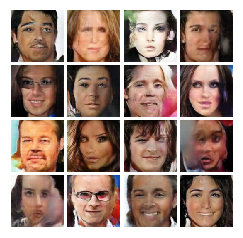


Iter: 4400, D: 0.141, G:0.5418


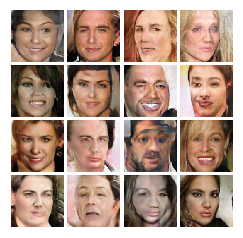


Iter: 4600, D: 0.06178, G:0.4538


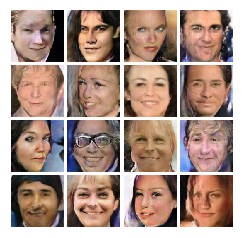


Iter: 4800, D: 0.1431, G:0.4661


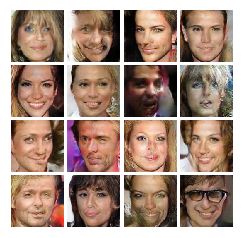


Iter: 5000, D: 0.1202, G:0.2942


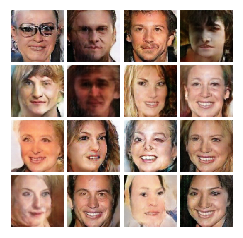


Iter: 5200, D: 0.06295, G:0.5308


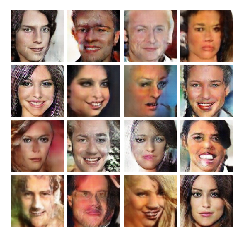


Iter: 5400, D: 0.05709, G:0.2849


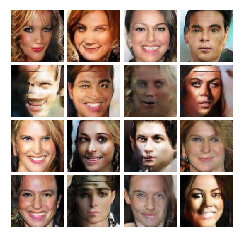


Iter: 5600, D: 0.04173, G:0.3944


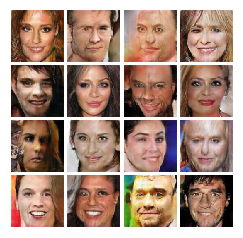


Iter: 5800, D: 0.04927, G:0.5124


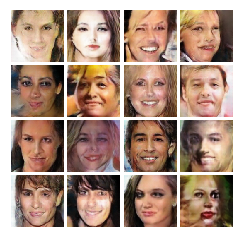


EPOCH:  4
Iter: 6000, D: 0.08675, G:0.205


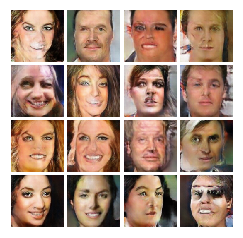


Iter: 6200, D: 0.08833, G:0.4487


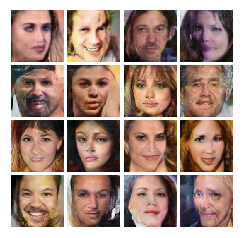


Iter: 6400, D: 0.2591, G:0.3461


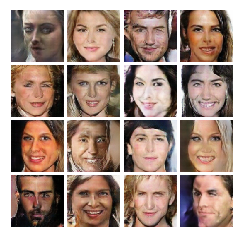


Iter: 6600, D: 0.09357, G:0.4088


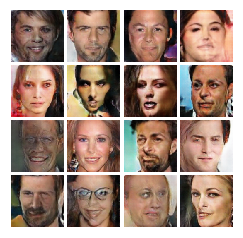


Iter: 6800, D: 0.07675, G:0.3983


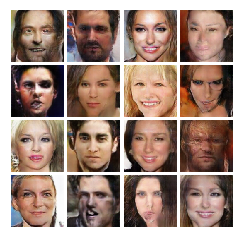


Iter: 7000, D: 0.02621, G:0.2889


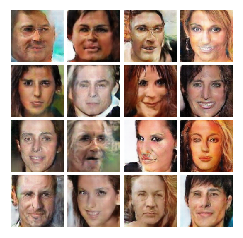


Iter: 7200, D: 0.04699, G:0.4982


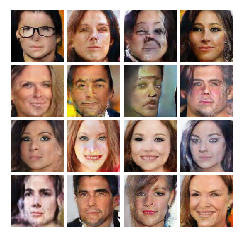


Iter: 7400, D: 0.06144, G:0.6343


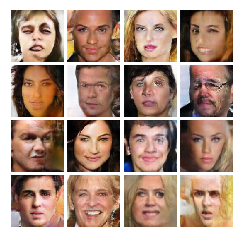


Iter: 7600, D: 0.06118, G:0.6752


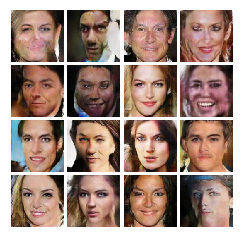


Iter: 7800, D: 0.05626, G:0.5106


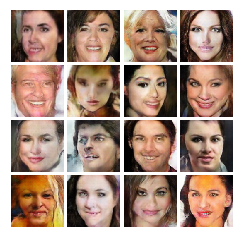


EPOCH:  5
Iter: 8000, D: 0.05568, G:0.3578


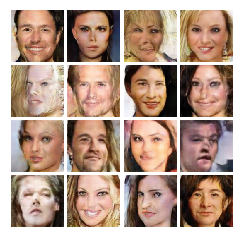


Iter: 8200, D: 0.03846, G:0.6308


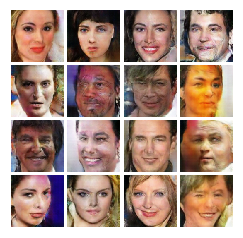


Iter: 8400, D: 0.118, G:0.3107


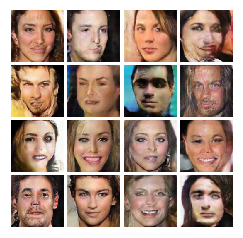


Iter: 8600, D: 0.02416, G:0.5853


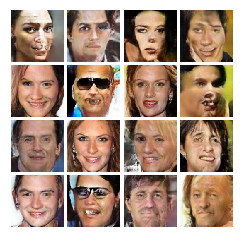


Iter: 8800, D: 0.01969, G:0.5641


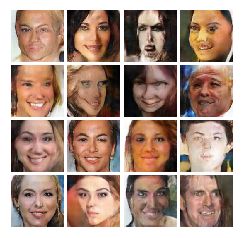


Iter: 9000, D: 0.1157, G:0.3003


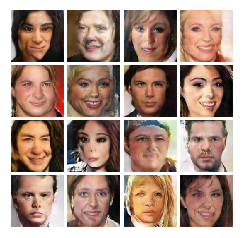


Iter: 9200, D: 0.1074, G:0.353


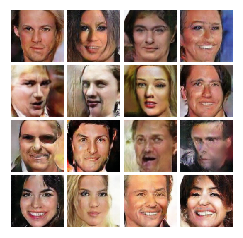


Iter: 9400, D: 0.149, G:0.8229


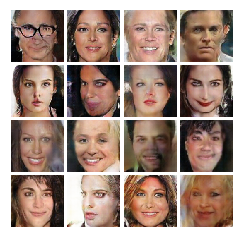


Iter: 9600, D: 0.3654, G:0.2511


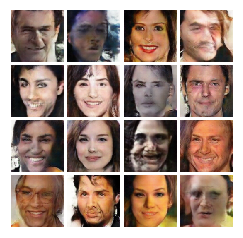


Iter: 9800, D: 0.0269, G:0.4549


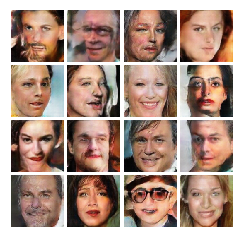


EPOCH:  6
Iter: 10000, D: 0.1246, G:0.3892


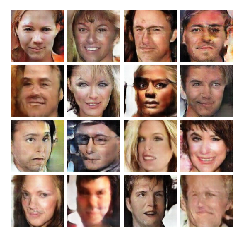


Iter: 10200, D: 0.01555, G:0.3847


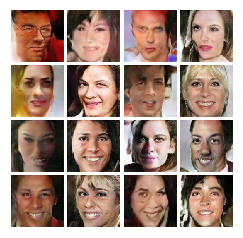


Iter: 10400, D: 0.05996, G:0.6182


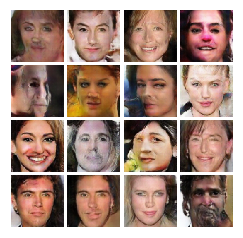


Iter: 10600, D: 0.02907, G:0.4271


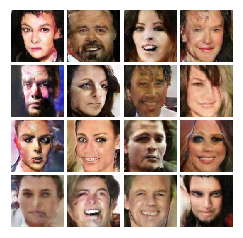


Iter: 10800, D: 0.04952, G:0.4614


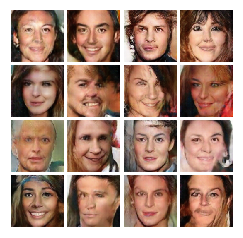


Iter: 11000, D: 0.04263, G:0.4722


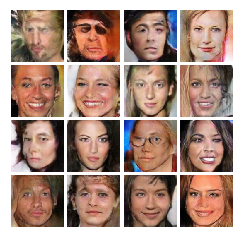


Iter: 11200, D: 0.02936, G:0.6164


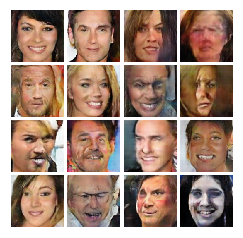


Iter: 11400, D: 0.02912, G:0.4654


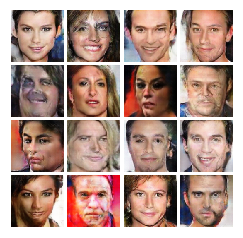


Iter: 11600, D: 0.02983, G:0.6753


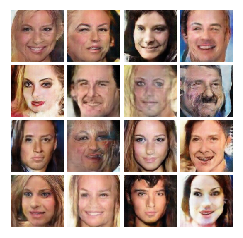


Iter: 11800, D: 0.02395, G:0.3625


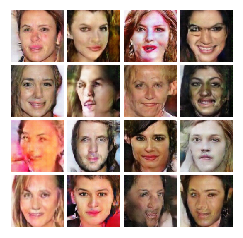


EPOCH:  7
Iter: 12000, D: 0.0291, G:0.4905


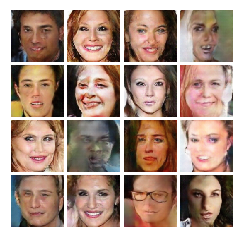


Iter: 12200, D: 0.01904, G:0.5289


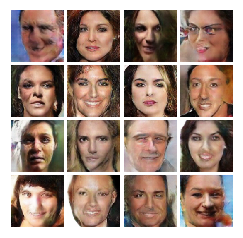


Iter: 12400, D: 0.04904, G:0.4883


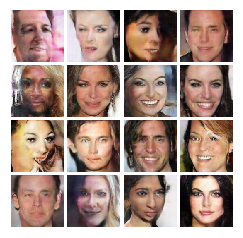


Iter: 12600, D: 0.03331, G:0.474


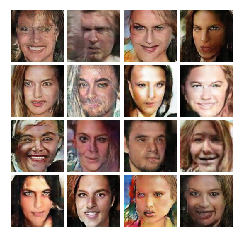


Iter: 12800, D: 0.01565, G:0.4394


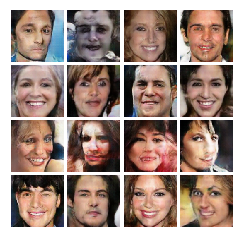


Iter: 13000, D: 0.03169, G:0.5025


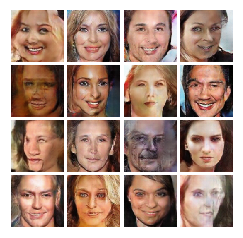


Iter: 13200, D: 0.01951, G:0.498


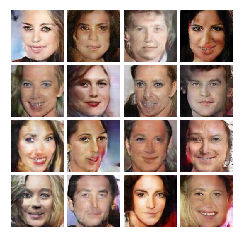


Iter: 13400, D: 0.01446, G:0.4638


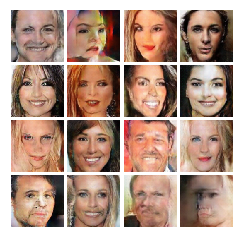


Iter: 13600, D: 0.08828, G:0.3078


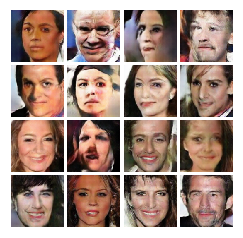


Iter: 13800, D: 0.06298, G:0.5273


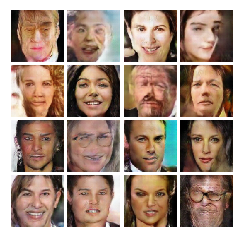


EPOCH:  8
Iter: 14000, D: 0.07074, G:0.5691


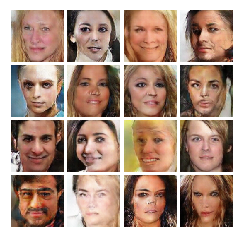


Iter: 14200, D: 0.04123, G:0.6622


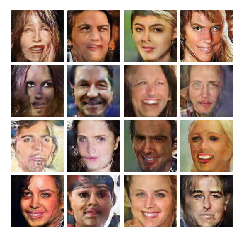


Iter: 14400, D: 0.0713, G:0.445


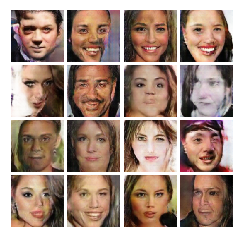


Iter: 14600, D: 0.01114, G:0.5294


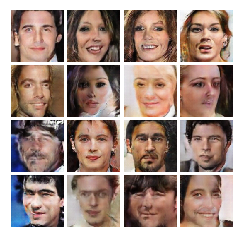


Iter: 14800, D: 0.00938, G:0.5048


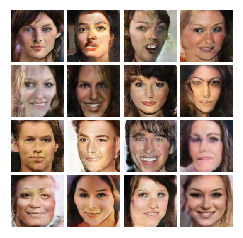


Iter: 15000, D: 0.02701, G:0.4971


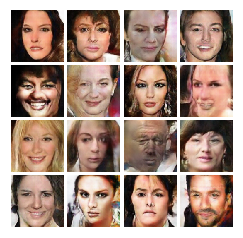


Iter: 15200, D: 0.01299, G:0.4464


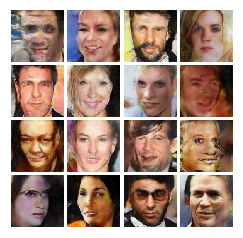


Iter: 15400, D: 0.02064, G:0.5952


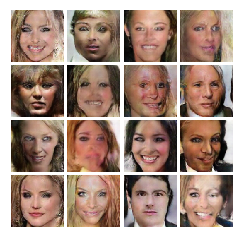


Iter: 15600, D: 0.02193, G:0.5194


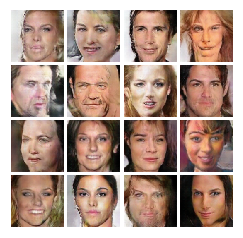


EPOCH:  9
Iter: 15800, D: 0.01607, G:0.5553


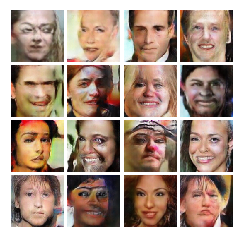


Iter: 16000, D: 0.01866, G:0.5224


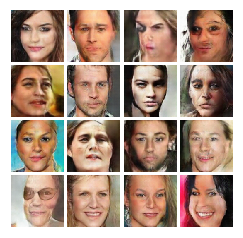


Iter: 16200, D: 0.01181, G:0.5814


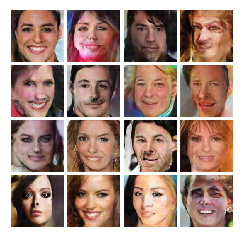


Iter: 16400, D: 0.01334, G:0.5154


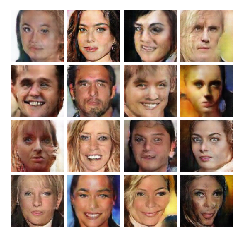


Iter: 16600, D: 0.01615, G:0.5382


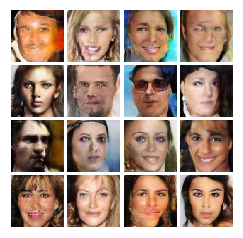


Iter: 16800, D: 0.01317, G:0.5431


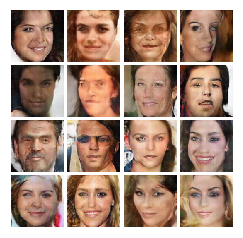


Iter: 17000, D: 0.029, G:0.6102


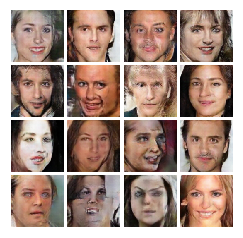


Iter: 17200, D: 0.102, G:0.3937


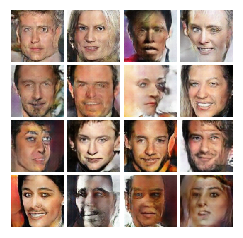


Iter: 17400, D: 0.08793, G:0.9036


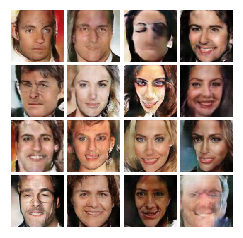


Iter: 17600, D: 0.08264, G:0.5219


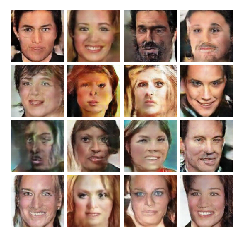


EPOCH:  10
Iter: 17800, D: 0.009271, G:0.5387


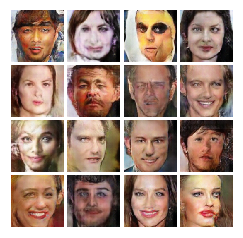


Iter: 18000, D: 0.008026, G:0.5551


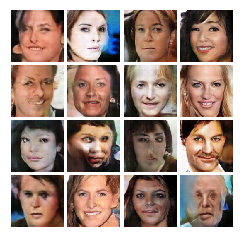


Iter: 18200, D: 0.009193, G:0.3713


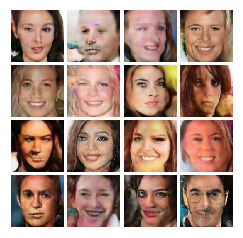


Iter: 18400, D: 0.03448, G:0.5061


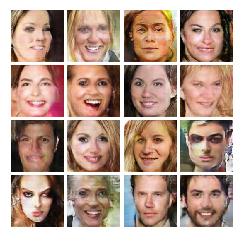


Iter: 18600, D: 0.02217, G:0.6884


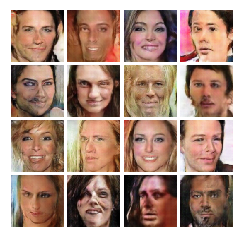


Iter: 18800, D: 0.01105, G:0.4285


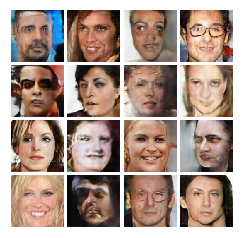


Iter: 19000, D: 0.02666, G:0.5628


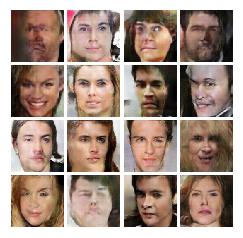


Iter: 19200, D: 0.009194, G:0.419


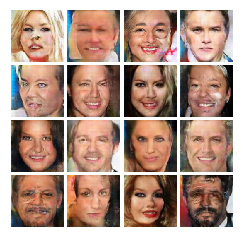


Iter: 19400, D: 0.005066, G:0.5096


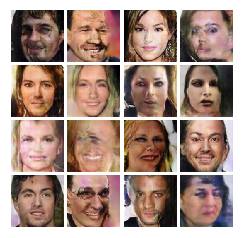


Iter: 19600, D: 0.02373, G:0.3995


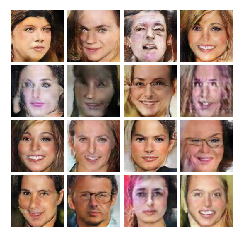


EPOCH:  11
Iter: 19800, D: 0.02567, G:0.5647


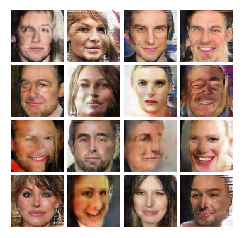


Iter: 20000, D: 0.01052, G:0.4981


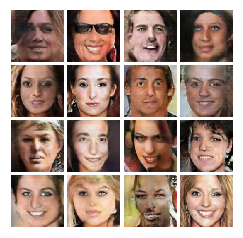


Iter: 20200, D: 0.01074, G:0.6118


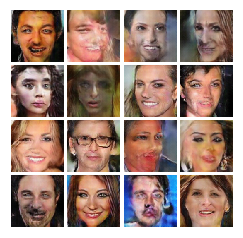


Iter: 20400, D: 0.004812, G:0.4794


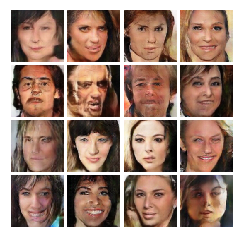


Iter: 20600, D: 0.005008, G:0.4906


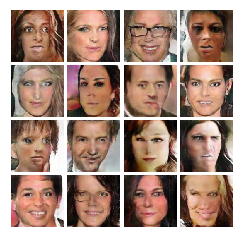


Iter: 20800, D: 0.01111, G:0.4544


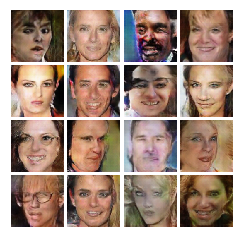


Iter: 21000, D: 0.03635, G:0.39


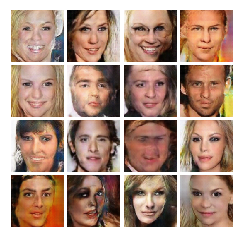


Iter: 21200, D: 0.009456, G:0.5602


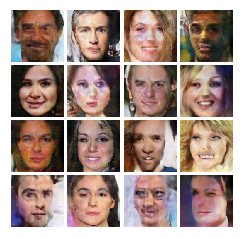


Iter: 21400, D: 0.01429, G:0.4397


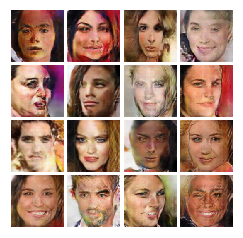


Iter: 21600, D: 0.01637, G:0.4148


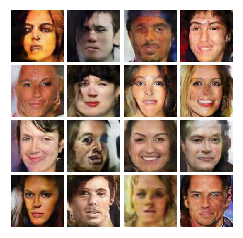


EPOCH:  12
Iter: 21800, D: 0.01106, G:0.4095


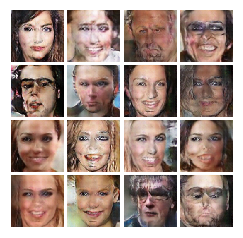


Iter: 22000, D: 0.03301, G:0.5208


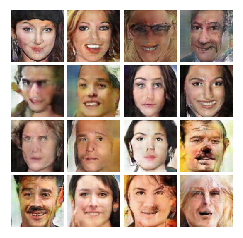


Iter: 22200, D: 0.004806, G:0.4491


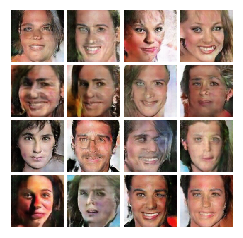


Iter: 22400, D: 0.01474, G:0.4648


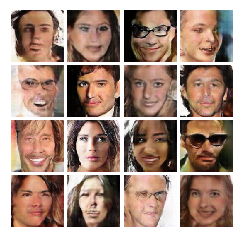


Iter: 22600, D: 0.003835, G:0.5026


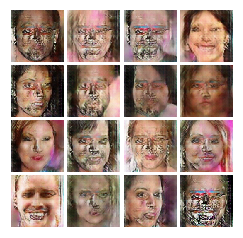


Iter: 22800, D: 0.005621, G:0.4958


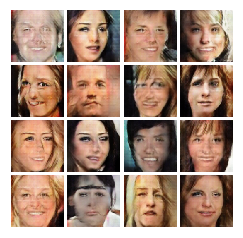


Iter: 23000, D: 0.005411, G:0.5147


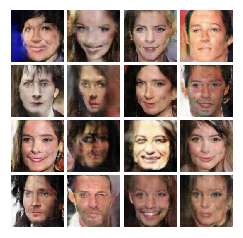


Iter: 23200, D: 0.05197, G:0.3356


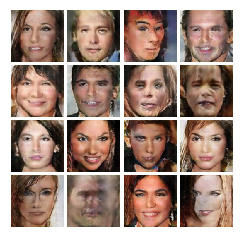


Iter: 23400, D: 0.01678, G:0.455


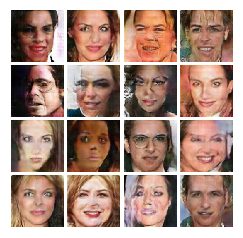


Iter: 23600, D: 0.03156, G:0.6318


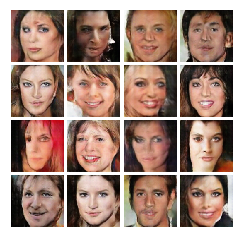


EPOCH:  13
Iter: 23800, D: 0.01438, G:0.5859


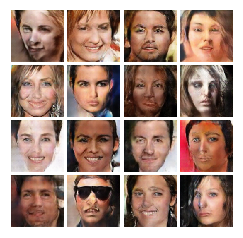


Iter: 24000, D: 0.03431, G:0.5879


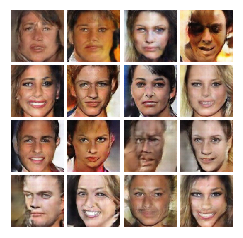


Iter: 24200, D: 0.009278, G:0.5603


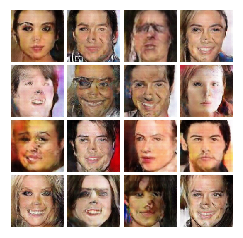


Iter: 24400, D: 0.03855, G:0.5893


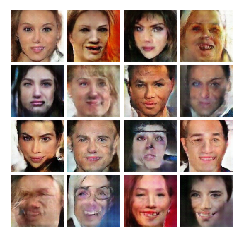


Iter: 24600, D: 0.02339, G:0.4883


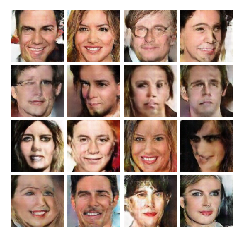


Iter: 24800, D: 0.0414, G:0.04359


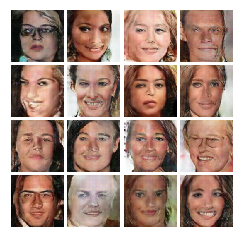


Iter: 25000, D: 0.01811, G:0.5149


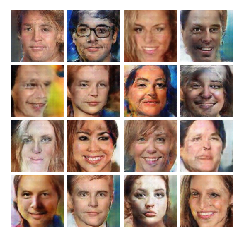


Iter: 25200, D: 0.05373, G:0.4475


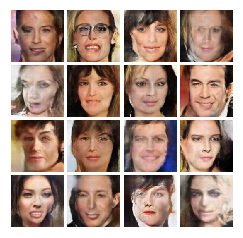


Iter: 25400, D: 0.01764, G:0.6618


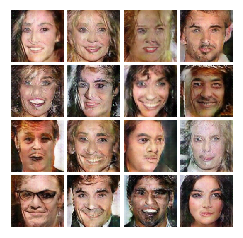


Iter: 25600, D: 0.06044, G:0.4759


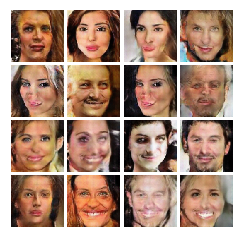


EPOCH:  14
Iter: 25800, D: 0.01469, G:0.419


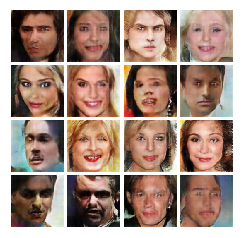


Iter: 26000, D: 0.01082, G:0.3484


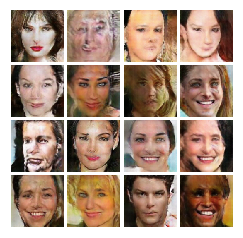


Iter: 26200, D: 0.009441, G:0.466


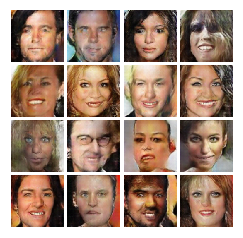


Iter: 26400, D: 0.07065, G:0.6659


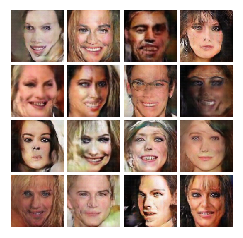


Iter: 26600, D: 0.03864, G:0.5774


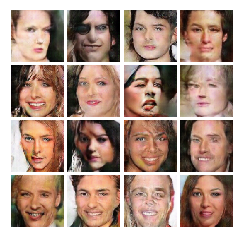


Iter: 26800, D: 0.05196, G:0.4844


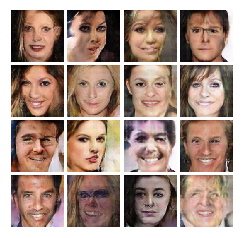


Iter: 27000, D: 0.007792, G:0.5244


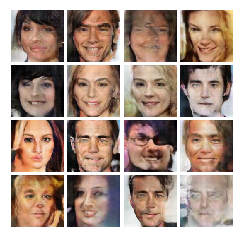


Iter: 27200, D: 0.01502, G:0.5358


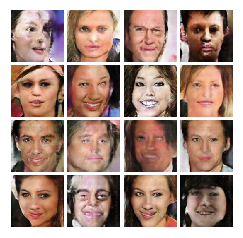


Iter: 27400, D: 0.03412, G:0.475


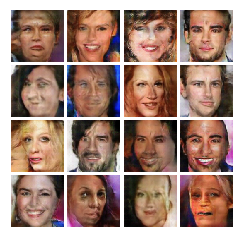


Iter: 27600, D: 0.005637, G:0.4947


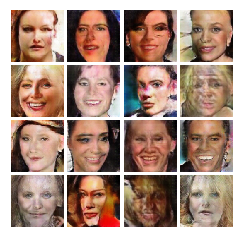


EPOCH:  15
Iter: 27800, D: 0.009358, G:0.57


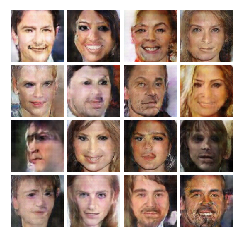


Iter: 28000, D: 0.002836, G:0.5493


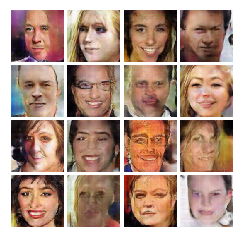


Iter: 28200, D: 0.008027, G:0.4879


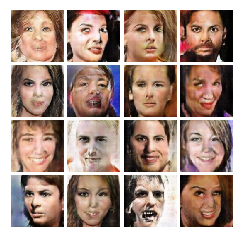


Iter: 28400, D: 0.009238, G:0.5407


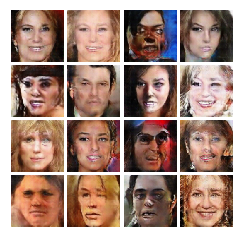


Iter: 28600, D: 0.02971, G:0.6175


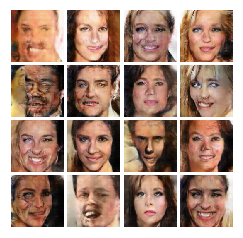


Iter: 28800, D: 0.01416, G:0.4577


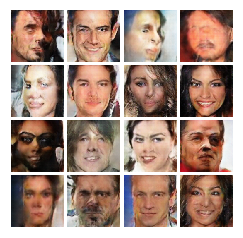


Iter: 29000, D: 0.007646, G:0.5453


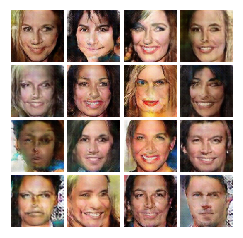


Iter: 29200, D: 0.009805, G:0.5993


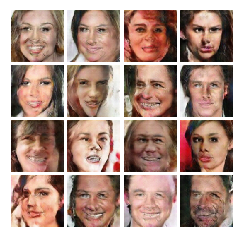


Iter: 29400, D: 0.02286, G:0.6872


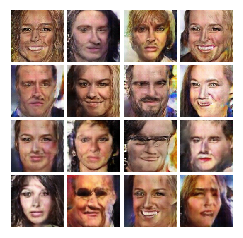


EPOCH:  16
Iter: 29600, D: 0.02645, G:0.4981


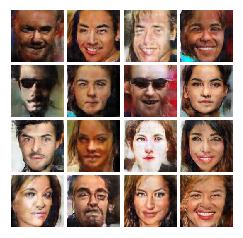


Iter: 29800, D: 0.00373, G:0.5029


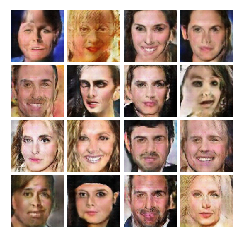


Iter: 30000, D: 0.006184, G:0.4934


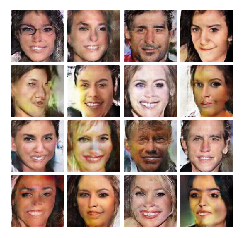


Iter: 30200, D: 0.01311, G:0.5057


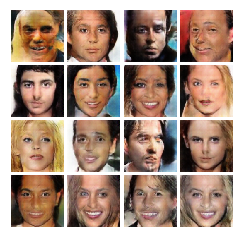


Iter: 30400, D: 0.02603, G:0.5974


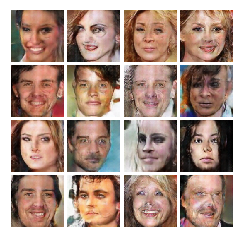


Iter: 30600, D: 0.008065, G:0.5062


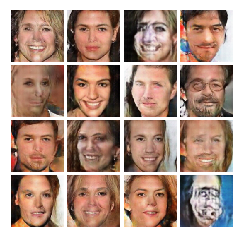


Iter: 30800, D: 0.004623, G:0.5317


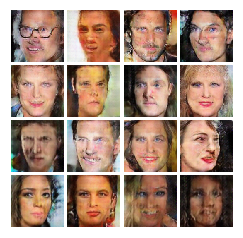


Iter: 31000, D: 0.004014, G:0.4617


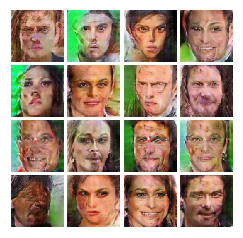


Iter: 31200, D: 0.0168, G:0.5581


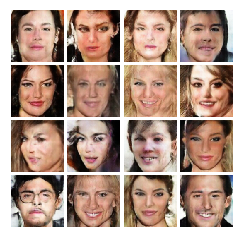


Iter: 31400, D: 0.02817, G:0.6907


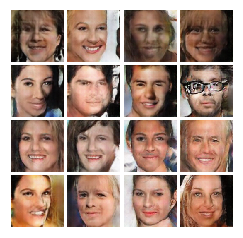


EPOCH:  17
Iter: 31600, D: 0.007628, G:0.4632


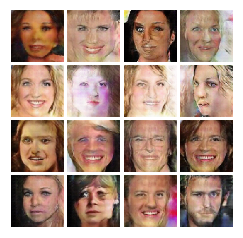


Iter: 31800, D: 0.009885, G:0.4856


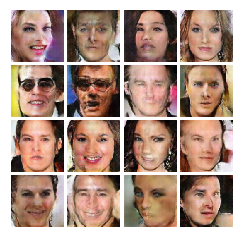


Iter: 32000, D: 0.005851, G:0.4867


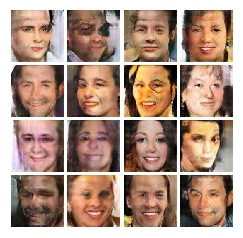


Iter: 32200, D: 0.01376, G:0.4873


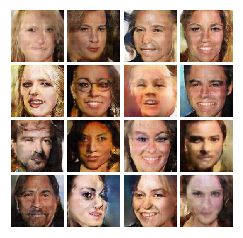


Iter: 32400, D: 0.005393, G:0.4045


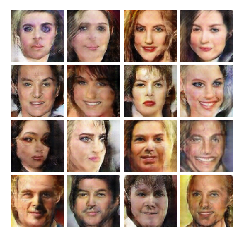


Iter: 32600, D: 0.01262, G:0.4526


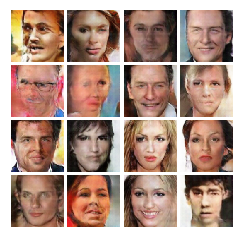


Iter: 32800, D: 0.005678, G:0.4909


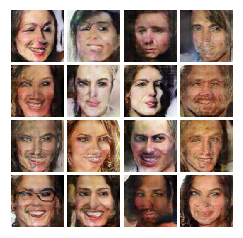


Iter: 33000, D: 0.06903, G:0.7114


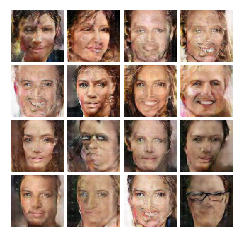


Iter: 33200, D: 0.008135, G:0.5789


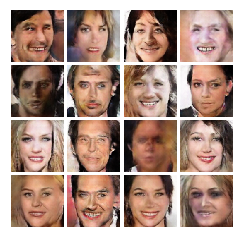


Iter: 33400, D: 0.002884, G:0.4284


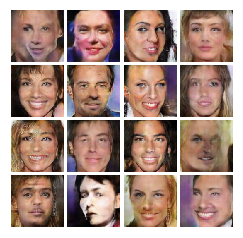


EPOCH:  18
Iter: 33600, D: 0.008483, G:0.4953


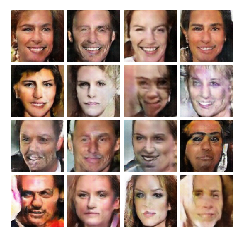


Iter: 33800, D: 0.02473, G:0.4335


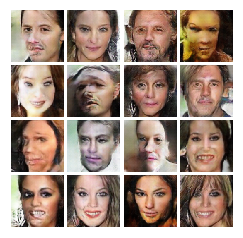


Iter: 34000, D: 0.006499, G:0.4479


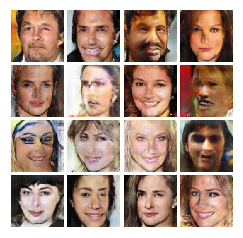


Iter: 34200, D: 0.04132, G:0.4089


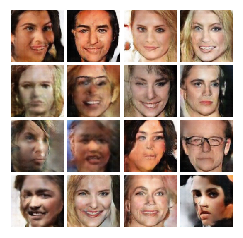


Iter: 34400, D: 0.008561, G:0.4837


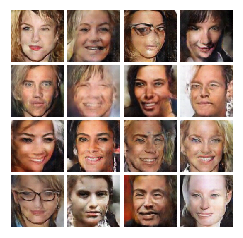


Iter: 34600, D: 0.02447, G:0.4552


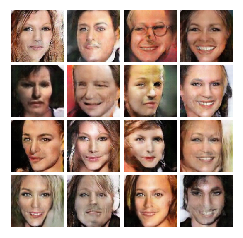


Iter: 34800, D: 0.01338, G:0.524


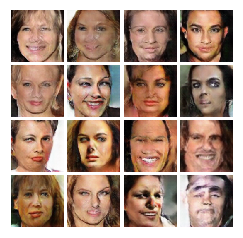


Iter: 35000, D: 0.04572, G:0.7852


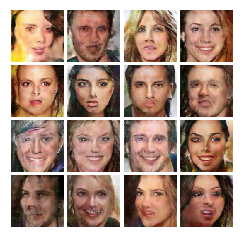


Iter: 35200, D: 0.004184, G:0.5323


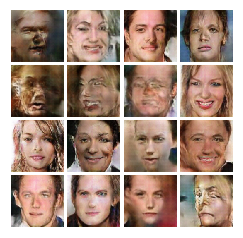


Iter: 35400, D: 0.002834, G:0.4966


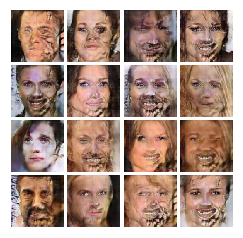


EPOCH:  19
Iter: 35600, D: 0.002057, G:0.5391


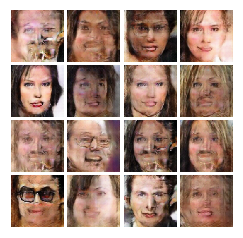

In [ ]:
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, batch_size=batch_size, show_every=200,
          train_loader=celeba_loader_train, device=device)